<a href="https://colab.research.google.com/github/Abhinendra-Singh/SIHTerrainRecog/blob/main/UG_MEAN_SHIFT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!apt-get install -y python3-gdal

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  python3-numpy
Suggested packages:
  gdal-bin python-numpy-doc python3-pytest
The following NEW packages will be installed:
  python3-gdal python3-numpy
0 upgraded, 2 newly installed, 0 to remove and 45 not upgraded.
Need to get 4,494 kB of archives.
After this operation, 23.9 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 python3-numpy amd64 1:1.21.5-1ubuntu22.04.1 [3,467 kB]
Get:2 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy/main amd64 python3-gdal amd64 3.6.4+dfsg-1~jammy0 [1,027 kB]
Fetched 4,494 kB in 1s (4,154 kB/s)
Selecting previously unselected package python3-numpy.
(Reading database ... 121920 files and directories currently installed.)
Preparing to unpack .../python3-numpy_1%3a1.21.5-1ubuntu22.04.1_amd64.deb ...
Unpacking python3-numpy (1:1.21.5-1ubuntu

In [1]:
import numpy as np
import cv2
from sklearn.cluster import MeanShift, estimate_bandwidth
from osgeo import gdal
from sklearn.ensemble import RandomForestClassifier
from skimage.measure import regionprops, label
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import os
import pandas as pd
from collections import defaultdict
import scipy
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, accuracy_score

In [2]:
image_path = '/content/drive/MyDrive/UG_MEANSHIFT/Images_SENT1/Copy of Subset_S1A_IW_GRDH_1SDV_20240112T125550_20240112T125615_052074_064B35_B529_Cal_Spk_TC_dB.tif'
dataset = gdal.Open(image_path, gdal.GA_ReadOnly)


In [ ]:
bands = []
for i in range(1, dataset.RasterCount + 1):
    band = dataset.GetRasterBand(i).ReadAsArray()
    bands.append(band)
image = np.stack(bands, axis=2)

In [ ]:
print(image.shape)

(2110, 6087, 2)


In [ ]:
image_normalized = np.zeros_like(image, dtype=np.float32)
for i in range(image.shape[2]):
    image_normalized[:, :, i] = cv2.normalize(image[:, :, i], None, 0, 255, cv2.NORM_MINMAX)


In [ ]:
print(image_normalized.shape)

(2110, 6087, 2)


In [ ]:
flat_image = image_normalized.reshape(-1, image.shape[2])

In [ ]:
print(flat_image.shape)

(12843570, 2)


Window size estimated automatically ---- 17*17

In [ ]:
bandwidth = estimate_bandwidth(flat_image, quantile=0.2, n_samples=500)
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True)
ms.fit(flat_image)

MeanShift(bandwidth=8.746797109145975, bin_seeding=True)

In [ ]:
print(bandwidth)

8.746797109145975


In [ ]:
labels = ms.labels_.reshape(image.shape[:2])

# Step 1: Segment the image into objects
labeled_image = label(labels)

(-0.5, 6086.5, 2109.5, -0.5)

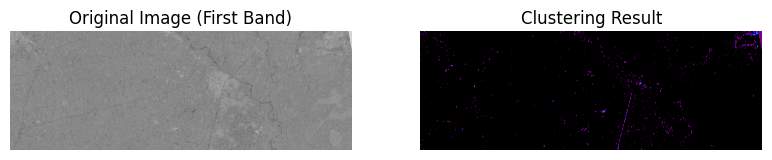

In [ ]:
plt.figure(figsize=(15, 10))

# Visualize the original image (first band)
plt.subplot(1, 3, 1)
plt.title('Original Image (First Band)')
plt.imshow(image[:, :, 0], cmap='gray')
plt.axis('off')

# Visualize the clustering result
plt.subplot(1, 3, 2)
plt.title('Clustering Result')
plt.imshow(labels, cmap='nipy_spectral')
plt.axis('off')

(-0.5, 6086.5, 2109.5, -0.5)

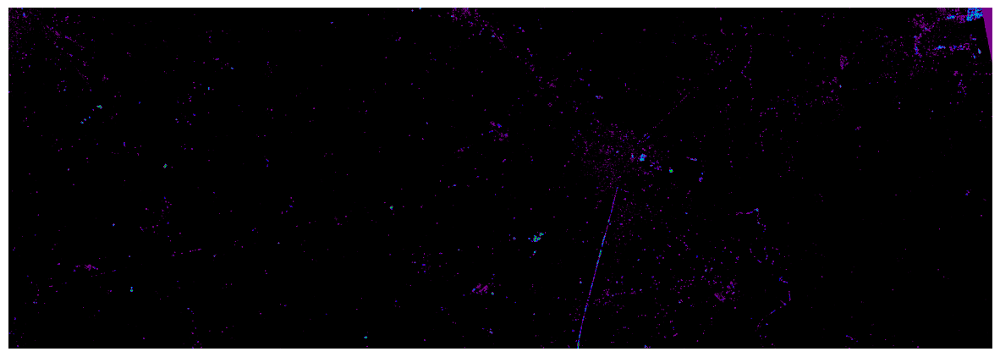

In [ ]:
plt.figure(figsize=(15, 10))
plt.plot(5, 8)
plt.imshow(labels, cmap='nipy_spectral')
plt.axis('off')

(-0.5, 6086.5, 2109.5, -0.5)

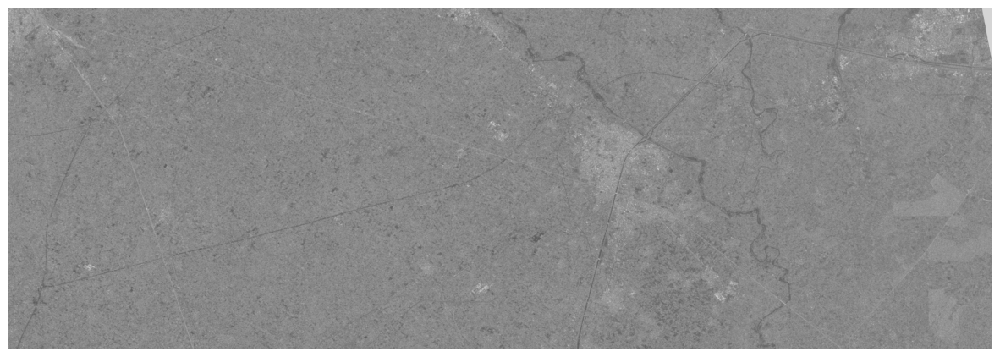

In [ ]:
plt.figure(figsize=(15, 10))
plt.plot(5, 8)
plt.imshow(image[:, :, 0], cmap='gray')
plt.axis('off')

Window size 3*3

In [ ]:
ms = MeanShift(bandwidth=1.5, bin_seeding=True)
ms.fit(flat_image)

MeanShift(bandwidth=1.5, bin_seeding=True)

In [ ]:
labels = ms.labels_.reshape(image.shape[:2])

# Step 1: Segment the image into objects
labeled_image = label(labels)

(-0.5, 6086.5, 2109.5, -0.5)

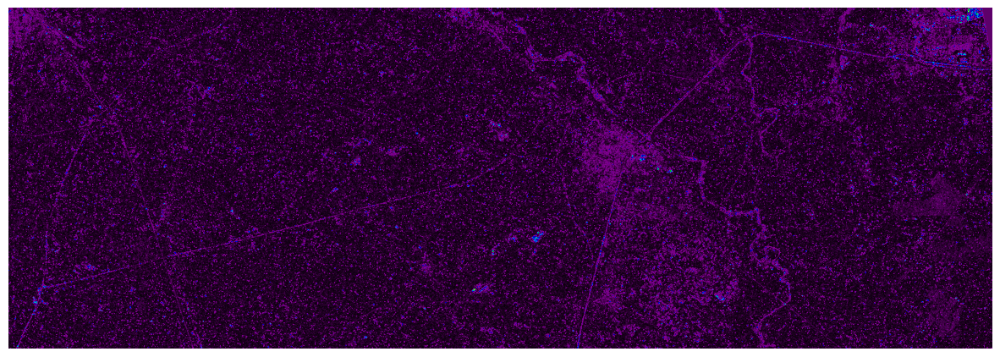

In [ ]:
plt.figure(figsize=(15, 10))
plt.plot(5, 8)
plt.imshow(labels, cmap='nipy_spectral')
plt.axis('off')

In [ ]:

baseName = os.path.basename(image_path)
output_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Result_'+ baseName

print(output_path)

/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Result_Copy of Subset_S1A_IW_GRDH_1SDV_20240112T125550_20240112T125615_052074_064B35_B529_Cal_Spk_TC_dB.tif


In [ ]:
def meanShiftCluster(image_path, windowSize):
  #Load the data
  dataset = gdal.Open(image_path, gdal.GA_ReadOnly)

  #Numpy array conversion stacking all the bands
  bands = []
  for i in range(1, dataset.RasterCount + 1):
      band = dataset.GetRasterBand(i).ReadAsArray()
      bands.append(band)
  image = np.stack(bands, axis=2)


# No need to normalize
  #image_normalized = np.zeros_like(image, dtype=np.float32)
  image_normalized = np.zeros_like(image, dtype=np.float32)
  for i in range(image.shape[2]):
      image_normalized[:, :, i] = cv2.normalize(image[:, :, i], None, 0, 255, cv2.NORM_MINMAX)

  # Flattening the image to 2D (number of pixels, number of bands)
  flat_image = image_normalized.reshape(-1, image.shape[2])

  print("Mean shift for the image")
  #Mean shift clustering main algo
  ms = MeanShift(bandwidth=windowSize, bin_seeding=True)
  ms.fit(flat_image)


  labels = ms.labels_.reshape(image.shape[:2])

  # Step 1: Segment the image into objects
  labeled_image = label(labels)

  #Writing it to the new tiff file
  baseName = os.path.basename(image_path)
  output_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Result_5w_'+ baseName
  driver = gdal.GetDriverByName('GTiff')
  out_dataset = driver.Create(output_path, dataset.RasterXSize, dataset.RasterYSize, 1, gdal.GDT_Int32)

  # Set geotransform and projection from the original dataset
  out_dataset.SetGeoTransform(dataset.GetGeoTransform())
  out_dataset.SetProjection(dataset.GetProjection())

  # Write the cluster labels to the output file
  out_band = out_dataset.GetRasterBand(1)
  out_band.WriteArray(labels)

  # Flush data to disk
  out_band.FlushCache()
  out_dataset.FlushCache()

  # Close the dataset
  del out_dataset

  print(f'Cluster labels saved as {output_path}')


In [ ]:
image_path = "/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Subset_S2A_MSIL2A_20221031T052951_N0400_R105_T43RGP_20221031T092457_resampled.tif"
dataset = gdal.Open(image_path, gdal.GA_ReadOnly)

count = 0;
# for i in image_paths:
# image_path = base_path + image_paths
print("Starting processing for ", count)
meanShiftCluster(image_path, 2.5)
count+= 1;

print("Clustering is done for all the input images!!")

Starting processing for  0
Mean shift for the image


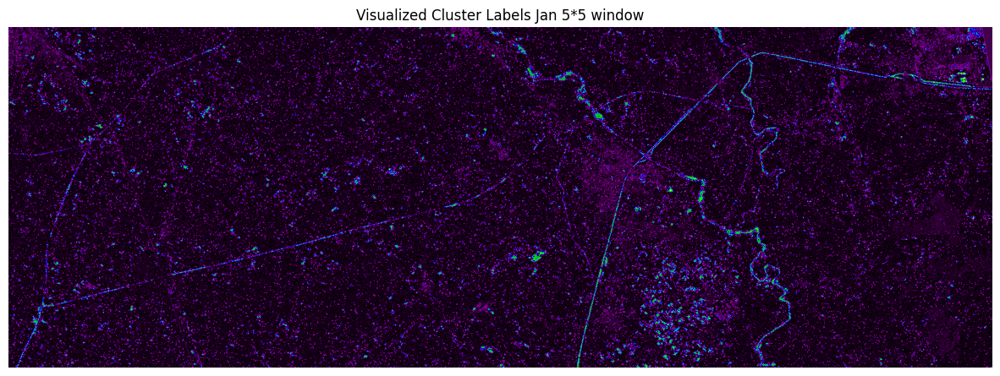

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from osgeo import gdal

# Path to the saved .tiff file with cluster labels
clustered_image_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Result_5w_Subset_S1A_IW_GRDH_1SDV_20240112T125550_20240112T125615_052074_064B35_B529_Cal_Spk_TC_dB.tif'

# Open the .tiff file using GDAL
clustered_dataset = gdal.Open(clustered_image_path, gdal.GA_ReadOnly)

# Read the cluster labels from the .tiff file
cluster_labels = clustered_dataset.GetRasterBand(1).ReadAsArray()

# Close the dataset
del clustered_dataset

# Visualize the cluster labels
plt.figure(figsize=(15, 10))
plt.title('Visualized Cluster Labels Jan 5*5 window')
plt.imshow(cluster_labels, cmap='nipy_spectral')
plt.axis('off')
plt.show()

## **Classification**

In [ ]:
image_paths = "/content/drive/MyDrive/2024/Subset_S1A_IW_GRDH_1SDV_20240112T125550_20240112T125615_052074_064B35_B529_Cal_Spk_TC_dB.tif"
dataset = gdal.Open(image_paths, gdal.GA_ReadOnly)

bands = []
for i in range(1, dataset.RasterCount + 1):
  band = dataset.GetRasterBand(i).ReadAsArray()
  bands.append(band)
image = np.stack(bands, axis=2)

geotransformOg = dataset.GetGeoTransform()
projectionOg = dataset.GetProjection()


In [ ]:
#clustered image
clustered_image_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Result_5w_Subset_S1A_IW_GRDH_1SDV_20240112T125550_20240112T125615_052074_064B35_B529_Cal_Spk_TC_dB.tif'
clustered_dataset = gdal.Open(clustered_image_path, gdal.GA_ReadOnly)

# Read the cluster labels from the .tiff file
cluster_labels = clustered_dataset.GetRasterBand(1).ReadAsArray()

# Get geotransform and projection information
geotransform = clustered_dataset.GetGeoTransform()
projection = clustered_dataset.GetProjection()

# Close the dataset
# del clustered_dataset

Calculating Statistics

In [ ]:
def segment_features(segment_pixels):
    features = []
    npixels, nbands = segment_pixels.shape
    for b in range(nbands):
        stats = scipy.stats.describe(segment_pixels[:, b])
        band_stats = list(stats.minmax) + list(stats)[2:]
        if npixels == 1:
            # In this case, the variance = nan, change it to 0.0
            band_stats[3] = 0.0
        features += band_stats
    return features

# Assuming image and cluster_labels are already defined
segments_id = np.unique(cluster_labels)
objects = [segment_features(image[cluster_labels == id]) for id in segments_id]

print(objects)

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:1087: RuntimeWarning: divide by zero encountered in divide
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:1087: RuntimeWarning: invalid value encountered in scalar multiply
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero


[[-17.487514, -16.298414, -16.949228, 0.09709870407336162, 0.1463544089192322, -1.0363811294531966, -11.434032, -7.262392, -10.280084, 0.5406217323916871, 0.7519779663267367, 0.18139102872623258], [-16.325293, -14.231304, -15.580156, 0.2170423664122424, 0.391659294109177, -0.6795101233631415, -10.871509, -10.051193, -10.481218, 0.04424548931450426, 0.13954805887920418, -1.1253326633718423], [-16.431608, -12.448715, -15.167326, 0.529977631427987, 0.5498701939271744, -0.20606364246711006, -13.792337, -10.791208, -11.486029, 0.25232111828776077, -1.0093819879180574, 0.7608245737348858], [-17.58733, -15.919153, -17.09313, 0.09591277654347778, 0.5357328793266102, -0.26660489445345714, -15.864366, -11.378075, -12.773877, 0.8491082923589977, -0.6411986322656906, -0.237713244053813], [-16.942337, -13.915285, -16.099192, 0.2381322381164077, 0.8770187233217768, 0.6272918961580225, -14.963355, -11.108615, -12.333294, 0.5398870403508444, -0.707852522101063, 0.006681264424442279], [-17.726482, -15.

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1

In [ ]:
#Labels CSV
csv_file_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Annotations_combined.csv'
df = pd.read_csv(csv_file_path)

In [ ]:
 df.head()

,Lon,Lat,Class
0,77.966060,29.929966,bs
1,77.966241,29.929060,bs
2,77.965601,29.928443,bs
3,77.965837,29.929430,bs
4,77.966668,29.929501,bs


In [ ]:
def geo_to_pixel(geo_x, geo_y, geotransform):
    ulx = geotransform[0]  # upper left x
    uly = geotransform[3]  # upper left y
    xres = geotransform[1]  # pixel width
    yres = geotransform[5]  # pixel height (negative value)

    pixel_x = int((geo_x - ulx) / xres)
    pixel_y = int((geo_y - uly) / yres)

    return pixel_x, pixel_y

In [ ]:
df['pixel_x'] = df.apply(lambda row: geo_to_pixel(row['Lon'], row['Lat'], geotransform)[0], axis=1)
df['pixel_y'] = df.apply(lambda row: geo_to_pixel(row['Lon'], row['Lat'], geotransform)[1], axis=1)

print(df.head())

         Lon        Lat Class  pixel_x  pixel_y
0  77.966060  29.929966    bs     4715      263
1  77.966241  29.929060    bs     4717      273
2  77.965601  29.928443    bs     4710      280
3  77.965837  29.929430    bs     4712      269
4  77.966668  29.929501    bs     4722      268


In [ ]:
segment_features_dict = {id: segment_features(image[cluster_labels == id]) for id in segments_id}


/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:1103: RuntimeWarning: divide by zero encountered in divide
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:1103: RuntimeWarning: invalid value encountered in scalar multiply
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero


In [ ]:
class_mapping = {'bs' : 1, 'ms': 2, 'sv' : 3, 'tv' : 4, 'ur' : 5, 'w': 6}
class_names = {1: 'bs', 2: 'ms', 3: 'sv', 4: 'tv', 5: 'ur', 6: 'w'}

#Will first count the number of classes assigned to match pixel of the clusters, the most frequent class will be assigned
#the main class label
# Create a dictionary to map each cluster to class counts
cluster_class_counts = defaultdict(lambda: defaultdict(int))
for _, row in df.iterrows():
    pixel_x, pixel_y = row['pixel_x'], row['pixel_y']
    if 0 <= pixel_x < cluster_labels.shape[1] and 0 <= pixel_y < cluster_labels.shape[0]:
        cluster_id = cluster_labels[pixel_y, pixel_x]
        class_id = class_mapping[row['Class']]
        cluster_class_counts[cluster_id][class_id] += 1

print("Sample cluster to class count mapping:\n", dict(list(cluster_class_counts.items())[:70]))

# Assign the most frequent class to each cluster
classified_image = np.zeros_like(cluster_labels, dtype=np.uint8)
for cluster_id, class_count in cluster_class_counts.items():
    most_frequent_class = max(class_count, key=class_count.get)
    classified_image[cluster_labels == cluster_id] = most_frequent_class

Sample cluster to class count mapping:
 {9: defaultdict(<class 'int'>, {1: 16, 3: 6, 4: 23, 5: 35}), 1: defaultdict(<class 'int'>, {1: 6, 3: 13, 4: 8, 5: 6, 6: 3}), 4: defaultdict(<class 'int'>, {1: 28, 2: 5, 3: 15, 4: 8, 5: 7, 6: 4}), 10: defaultdict(<class 'int'>, {1: 3, 3: 3, 4: 20, 5: 30}), 8: defaultdict(<class 'int'>, {1: 12, 3: 8, 4: 13, 5: 21}), 6: defaultdict(<class 'int'>, {1: 68, 2: 94, 3: 76, 4: 13, 5: 6, 6: 26}), 3: defaultdict(<class 'int'>, {1: 35, 2: 7, 3: 18, 4: 5, 5: 4, 6: 6}), 5: defaultdict(<class 'int'>, {1: 14, 2: 2, 3: 8, 4: 50, 5: 32, 6: 3}), 7: defaultdict(<class 'int'>, {1: 21, 2: 12, 3: 46, 4: 24, 5: 13, 6: 9}), 0: defaultdict(<class 'int'>, {1: 23, 2: 6, 3: 28, 4: 28, 5: 19, 6: 2}), 257: defaultdict(<class 'int'>, {1: 1, 2: 2}), 2: defaultdict(<class 'int'>, {1: 15, 2: 2, 3: 18, 4: 16, 5: 28, 6: 2}), 13: defaultdict(<class 'int'>, {1: 2, 3: 1, 5: 3}), 244: defaultdict(<class 'int'>, {1: 1, 2: 15, 6: 8}), 380: defaultdict(<class 'int'>, {1: 1, 2: 6, 4: 1}), 1

In [ ]:
labels = []
features = []

# Ensure that the pixel coordinates are within bounds
height, width = cluster_labels.shape

for idx, row in df.iterrows():
    px, py = int(row['pixel_x']), int(row['pixel_y'])
    if 0 <= px < width and 0 <= py < height:
        segment_id = cluster_labels[py, px]
        features.append(segment_features_dict[segment_id])
        labels.append(class_mapping[row['Class']])
    else:
        print(f"Coordinate ({px}, {py}) is out of bounds for the image of size ({height}, {width})")


Coordinate (-199, 940) is out of bounds for the image of size (2110, 6087)
Coordinate (-205, 951) is out of bounds for the image of size (2110, 6087)
Coordinate (-195, 948) is out of bounds for the image of size (2110, 6087)
Coordinate (-196, 956) is out of bounds for the image of size (2110, 6087)
Coordinate (-205, 956) is out of bounds for the image of size (2110, 6087)
Coordinate (-204, 961) is out of bounds for the image of size (2110, 6087)
Coordinate (-209, 964) is out of bounds for the image of size (2110, 6087)
Coordinate (-175, 991) is out of bounds for the image of size (2110, 6087)
Coordinate (-158, 991) is out of bounds for the image of size (2110, 6087)
Coordinate (-156, 998) is out of bounds for the image of size (2110, 6087)
Coordinate (-167, 998) is out of bounds for the image of size (2110, 6087)
Coordinate (-164, 1008) is out of bounds for the image of size (2110, 6087)
Coordinate (-162, 1015) is out of bounds for the image of size (2110, 6087)
Coordinate (-156, 979) 

In [ ]:
features = np.array(features)
labels = np.array(labels)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.3, random_state=42)


In [ ]:
clf = RandomForestClassifier(n_jobs=1)
clf.fit(X_train, y_train)

RandomForestClassifier(n_jobs=1)

In [ ]:
y_pred = clf.predict(X_test)
print("Classification Report:")
print(classification_report(y_test, y_pred, target_names=class_mapping.keys()))
print("Accuracy:", accuracy_score(y_test, y_pred))

Classification Report:
              precision    recall  f1-score   support

          bs       0.40      0.24      0.30        70
          ms       0.46      0.79      0.58        73
          sv       0.36      0.16      0.22        76
          tv       0.31      0.39      0.35        56
          ur       0.50      0.66      0.57        73
           w       0.82      0.28      0.42        32

    accuracy                           0.44       380
   macro avg       0.47      0.42      0.41       380
weighted avg       0.44      0.44      0.41       380

Accuracy: 0.4368421052631579


In [ ]:
#creating training image

train_img = np.copy(cluster_labels)

In [ ]:
classes = list(class_mapping.values())
cluster_class_counts = defaultdict(lambda: defaultdict(int))


In [ ]:
segments_per_class = defaultdict(list)
for cluster_id in np.unique(cluster_labels):
    if cluster_id in cluster_class_counts:
        most_frequent_class = max(cluster_class_counts[cluster_id], key=cluster_class_counts[cluster_id].get)
        segments_per_class[most_frequent_class].append(cluster_id)

print("Segments per class:\n", dict(segments_per_class))


Segments per class:
 {}


In [ ]:
train_img = np.copy(cluster_labels)
threshold = train_img.max() +1

for klass in classes:
  class_label = threshold + klass
  for segment_id in segments_per_class[klass]:
    train_img[train_img == segment_id] = class_label



In [ ]:
print(objects)

[[-17.487514, -16.298414, -16.949228, 0.09709870407336162, 0.1463544089192322, -1.0363811294531966, -11.434032, -7.262392, -10.280084, 0.5406217323916871, 0.7519779663267367, 0.18139102872623258], [-16.325293, -14.231304, -15.580156, 0.2170423664122424, 0.391659294109177, -0.6795101233631415, -10.871509, -10.051193, -10.481218, 0.04424548931450426, 0.13954805887920418, -1.1253326633718423], [-16.431608, -12.448715, -15.167326, 0.529977631427987, 0.5498701939271744, -0.20606364246711006, -13.792337, -10.791208, -11.486029, 0.25232111828776077, -1.0093819879180574, 0.7608245737348858], [-17.58733, -15.919153, -17.09313, 0.09591277654347778, 0.5357328793266102, -0.26660489445345714, -15.864366, -11.378075, -12.773877, 0.8491082923589977, -0.6411986322656906, -0.237713244053813], [-16.942337, -13.915285, -16.099192, 0.2381322381164077, 0.8770187233217768, 0.6272918961580225, -14.963355, -11.108615, -12.333294, 0.5398870403508444, -0.707852522101063, 0.006681264424442279], [-17.726482, -15.

In [ ]:
#prepare training objects and labels
training_obj = []
training_labels = []

for klass in classes:
    class_train_object = [v for i, v in enumerate(objects) if segments_id[i] in segments_per_class[klass]]
    training_labels += [klass] * len(class_train_object)
    training_obj += class_train_object
    print('Training objects for class', klass, ':', len(class_train_object))

Training objects for class 1 : 0
Training objects for class 2 : 0
Training objects for class 3 : 0
Training objects for class 4 : 0
Training objects for class 5 : 0
Training objects for class 6 : 0


In [ ]:
#Shows each clusters are assigned which class
cluster_summary = {}
for cluster_id in np.unique(cluster_labels):
    mask = cluster_labels == cluster_id
    unique, counts = np.unique(classified_image[mask], return_counts=True)
    cluster_summary[cluster_id] = dict(zip(unique, counts))

for cluster_id, summary in cluster_summary.items():
    print(f"Cluster {cluster_id}: {summary}")

Cluster 0: {3: 1378726}
Cluster 1: {3: 590896}
Cluster 2: {5: 1084648}
Cluster 3: {1: 1076909}
Cluster 4: {1: 1066682}
Cluster 5: {4: 921586}
Cluster 6: {2: 2755546}
Cluster 7: {3: 1683052}
Cluster 8: {5: 465730}
Cluster 9: {5: 637947}
Cluster 10: {5: 379423}
Cluster 11: {5: 164940}
Cluster 12: {5: 92324}
Cluster 13: {5: 54330}
Cluster 14: {0: 11365}
Cluster 15: {5: 30100}
Cluster 16: {5: 21838}
Cluster 17: {5: 34131}
Cluster 18: {0: 9117}
Cluster 19: {0: 5727}
Cluster 20: {5: 5108}
Cluster 21: {0: 1095}
Cluster 22: {0: 12817}
Cluster 23: {0: 703}
Cluster 24: {0: 456}
Cluster 25: {0: 1130}
Cluster 26: {0: 2217}
Cluster 27: {0: 476}
Cluster 28: {0: 386}
Cluster 29: {0: 1009}
Cluster 30: {0: 385}
Cluster 31: {0: 632}
Cluster 32: {0: 426}
Cluster 33: {0: 411}
Cluster 34: {0: 402}
Cluster 35: {0: 138}
Cluster 36: {0: 191}
Cluster 37: {0: 234}
Cluster 38: {0: 366}
Cluster 39: {0: 166}
Cluster 40: {0: 585}
Cluster 41: {0: 172}
Cluster 42: {0: 189}
Cluster 43: {0: 356}
Cluster 44: {0: 259}
Cl

In [ ]:
#This will show how many pixels are assigned to each classes
unique, counts = np.unique(classified_image, return_counts=True)
class_distribution = dict(zip(unique, counts))
print(class_distribution)

{0: 102628, 1: 2145173, 2: 3009907, 3: 3663830, 4: 921586, 5: 2976596, 6: 23850}


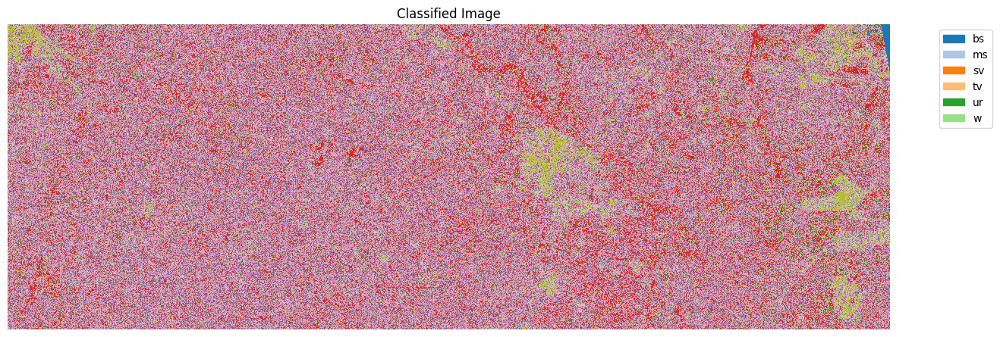

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# Plot the classified image with legend
plt.figure(figsize=(15, 10))
plt.title('Classified Image')

# Display the classified image
im = plt.imshow(classified_image, cmap='tab20')
plt.axis('off')

# Create a color bar as legend
cmap = plt.get_cmap('tab20')
colors = [cmap(i) for i in range(len(class_mapping))]
custom_cmap = ListedColormap(colors)
legend_patches = [mpatches.Patch(color=custom_cmap(i), label=class_names[i+1]) for i in range(len(class_mapping))]
plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

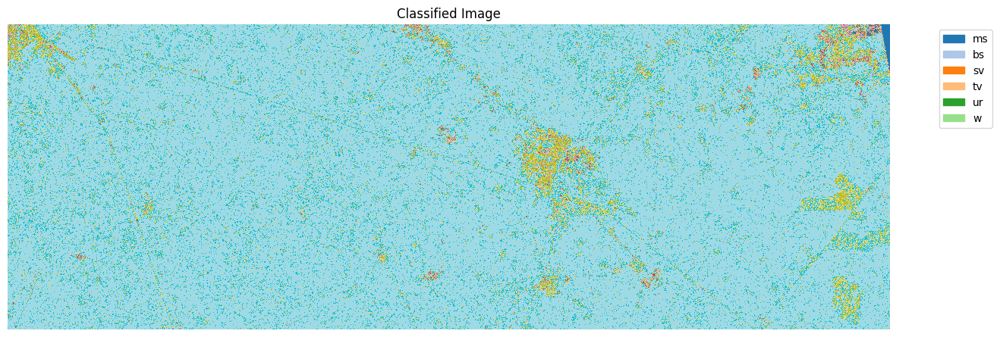

In [ ]:


plt.figure(figsize=(15, 10))
plt.title('Classified Image')

# Display the classified image
im = plt.imshow(classified_image, cmap='tab20')
plt.axis('off')

# Create a color bar as legend
from matplotlib.colors import ListedColormap

# Get the colormap from the image
cmap = plt.get_cmap('tab20')
colors = [cmap(i) for i in range(len(class_mapping))]

# Create a custom colormap and a legend
custom_cmap = ListedColormap(colors)

# Plot legend patches
import matplotlib.patches as mpatches
legend_patches = [mpatches.Patch(color=custom_cmap(i), label=class_names[i+1]) for i in range(len(class_mapping))]
plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

# plt.figure(figsize=(15, 10))
# plt.title('Classified Image')
# plt.imshow(classified_image, cmap='tab20')
# plt.axis('off')
# plt.show()

In [ ]:
#saving the classified image as .tiff

classified_image_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Filtered_Labelled_image_5w.tif'


driver = gdal.GetDriverByName('GTiff')
out_dataset = driver.Create(classified_image_path, cluster_labels.shape[1], cluster_labels.shape[0], 1, gdal.GDT_Byte)

# Set geotransform and projection from the original dataset
out_dataset.SetGeoTransform(geotransform)
out_dataset.SetProjection(projection)

# Write the classified image to the output file
out_band = out_dataset.GetRasterBand(1)
out_band.WriteArray(classified_image)

# Flush data to disk and close the dataset
out_band.FlushCache()
out_dataset.FlushCache()
del out_dataset

print(f'Classified image saved as {classified_image_path}')

Classified image saved as /content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Filtered_Labelled_image_5w.tif


Classification using Random forest

In [ ]:
#extracting the labels and features
features = []
labels = []

df = df.sample(frac=1, random_state=42).reset_index(drop=True)

for _, row in df.iterrows():
  pixel_x, pixel_y = row['pixel_x'], row['pixel_y']
  if 0 <= pixel_x < cluster_labels.shape[1] and 0 <= pixel_y < cluster_labels.shape[0]:
     cluster_id = cluster_labels[pixel_y, pixel_x]
     features.append(cluster_id)
     labels.append(class_mapping[row['Class']])


features = np.array(features).reshape(-1,1)
labels = np.array(labels)


In [ ]:
print('Features:', features[:5])
print('Labels:', labels[:5])

Features: [[6]
 [2]
 [7]
 [4]
 [7]]
Labels: [3 4 2 3 4]


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, accuracy_score

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.3, random_state=42)


In [ ]:
param_grid = {
    'n_estimators': [50, 100, 200, 250],
    'max_depth': [None, 10, 20, 30, 40],
    'min_samples_split': [2, 5, 10, 15],
    'min_samples_leaf': [1, 2, 4, 6]
}

# Initialize the Random Forest classifier
rf = RandomForestClassifier(random_state=42)

# Initialize Grid Search with cross-validation
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)

# Fit Grid Search to the training data
grid_search.fit(X_train, y_train)

# Get the best parameters and best estimator
best_params = grid_search.best_params_
best_rf = grid_search.best_estimator_

print("Best parameters found: ", best_params)

Fitting 5 folds for each of 320 candidates, totalling 1600 fits
Best parameters found:  {'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}


In [ ]:
y_pred = best_rf.predict(X_test)

In [ ]:
print("Classification Report:")
print(classification_report(y_test, y_pred, target_names=class_names.values()))
print("Accuracy:", accuracy_score(y_test, y_pred))

Classification Report:
              precision    recall  f1-score   support

          ms       0.29      0.42      0.34        64
          bs       0.59      0.51      0.55        71
          sv       0.34      0.28      0.31        75
          tv       0.40      0.34      0.37        64
          ur       0.44      0.56      0.49        75
           w       0.80      0.39      0.52        31

    accuracy                           0.42       380
   macro avg       0.48      0.42      0.43       380
weighted avg       0.45      0.42      0.42       380

Accuracy: 0.42105263157894735


In [ ]:
rf_classifier = RandomForestClassifier(n_estimators=100, max_depth =10, min_samples_leaf=1, min_samples_split=2, random_state=42)
rf_classifier.fit(X_train, y_train)

RandomForestClassifier(max_depth=10, random_state=42)

In [ ]:
y_pred = rf_classifier.predict(X_test)

# Evaluate the classifier
print("Classification Report:")
print(classification_report(y_test, y_pred, target_names=class_names.values()))
print("Accuracy:", accuracy_score(y_test, y_pred))

# Classify each pixel in the cluster image
# classified_image = np.zeros_like(cluster_labels, dtype=np.uint8)

# for i in range(cluster_labels.shape[0]):
#     for j in range(cluster_labels.shape[1]):
#         cluster_id = cluster_labels[i, j]
#         classified_image[i, j] = rf_classifier.predict([[cluster_id]])

# # Visualization with a legend
# plt.figure(figsize=(15, 10))
# plt.title('Classified Image using Random Forest')

# # Display the classified image
# im = plt.imshow(classified_image, cmap='tab20')
# plt.axis('off')


Classification Report:
              precision    recall  f1-score   support

          bs       0.22      0.28      0.25        64
          ms       0.41      0.75      0.53        71
          sv       0.25      0.15      0.18        75
          tv       0.70      0.30      0.42        64
          ur       0.53      0.63      0.57        75
           w       0.78      0.23      0.35        31

    accuracy                           0.41       380
   macro avg       0.48      0.39      0.38       380
weighted avg       0.45      0.41      0.39       380

Accuracy: 0.40789473684210525


In [ ]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=42)
features_resampled, labels_resampled = smote.fit_resample(features, labels)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features_resampled, labels_resampled, test_size=0.3, random_state=42)

# Define the parameter grid for Grid Search
param_grid = {
    'n_estimators': [50, 100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2', None]
}

# Initialize the Random Forest classifier
rf = RandomForestClassifier(random_state=42)

# Initialize Grid Search with cross-validation
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=StratifiedKFold(n_splits=5), n_jobs=-1, verbose=2)

# Fit Grid Search to the training data
grid_search.fit(X_train, y_train)

# Get the best parameters and best estimator
best_params = grid_search.best_params_
best_rf = grid_search.best_estimator_

print("Best parameters found: ", best_params)

# Predict on the test set using the best estimator
y_pred = best_rf.predict(X_test)

# Evaluate the classifier
print("Classification Report:")
print(classification_report(y_test, y_pred, target_names=class_names.values()))
print("Accuracy:", accuracy_score(y_test, y_pred))

Fitting 5 folds for each of 432 candidates, totalling 2160 fits
Best parameters found:  {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
Classification Report:
              precision    recall  f1-score   support

          ms       0.32      0.35      0.34        74
          bs       0.55      0.59      0.57        78
          sv       0.29      0.20      0.24        74
          tv       0.34      0.39      0.36        69
          ur       0.45      0.53      0.48        78
           w       0.61      0.49      0.55        77

    accuracy                           0.43       450
   macro avg       0.43      0.43      0.42       450
weighted avg       0.43      0.43      0.43       450

Accuracy: 0.4288888888888889


In [ ]:
y_pred_train = best_rf.predict(X_train)

print("Accuracy:", accuracy_score(y_train, y_pred_train))

Accuracy: 0.4961904761904762


CLassification 2 exp

In [ ]:
#clustered image
clustered_image_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Result_Subset_S1A_IW_GRDH_1SDV_20240112T125550_20240112T125615_052074_064B35_B529_Cal_Spk_TC_dB.tif'
clustered_dataset = gdal.Open(clustered_image_path, gdal.GA_ReadOnly)

# Read the cluster labels from the .tiff file
cluster_labels = clustered_dataset.GetRasterBand(1).ReadAsArray()

# Get geotransform and projection information
geotransform = clustered_dataset.GetGeoTransform()
projection = clustered_dataset.GetProjection()

# Close the dataset
del clustered_dataset

In [ ]:
def segment_features(segment_pixels):
    features = []
    npixels, nbands = segment_pixels.shape

    for b in range(nbands):
        band = segment_pixels[:, b]

        # Normalize the band to the range 0-255 and convert to uint8
        band_norm = cv2.normalize(band, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

        # Statistical features
        stats = scipy.stats.describe(band)
        band_stats = list(stats.minmax) + list(stats)[2:]
        if npixels == 1:
            band_stats[3] = 0.0  # Variance is NaN for single pixel, set it to 0
        features += band_stats

        # Texture features
        if npixels > 1:
            glcm = greycomatrix(band_norm.reshape(-1, 1), [1], [0], symmetric=True, normed=True)
            contrast = greycoprops(glcm, 'contrast')[0, 0]
            dissimilarity = greycoprops(glcm, 'dissimilarity')[0, 0]
            homogeneity = greycoprops(glcm, 'homogeneity')[0, 0]
            energy = greycoprops(glcm, 'energy')[0, 0]
            correlation = greycoprops(glcm, 'correlation')[0, 0]
            features += [contrast, dissimilarity, homogeneity, energy, correlation]
        else:
            features += [0, 0, 0, 0, 0]  # Default values for single pixel segments

    return features


In [ ]:
def geo_to_pixel(geo_x, geo_y, geotransform):
    ulx = geotransform[0]
    uly = geotransform[3]
    xres = geotransform[1]
    yres = geotransform[5]
    pixel_x = int((geo_x - ulx) / xres)
    pixel_y = int((geo_y - uly) / yres)
    return pixel_x, pixel_y

In [ ]:
csv_file_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Annotations_combined.csv'
df = pd.read_csv(csv_file_path)

In [ ]:
df.head()

,Lon,Lat,Class
0,77.966060,29.929966,bs
1,77.966241,29.929060,bs
2,77.965601,29.928443,bs
3,77.965837,29.929430,bs
4,77.966668,29.929501,bs


In [ ]:
df['pixel_x'] = df.apply(lambda row: geo_to_pixel(row['Lon'], row['Lat'], geotransform)[0], axis=1)
df['pixel_y'] = df.apply(lambda row: geo_to_pixel(row['Lon'], row['Lat'], geotransform)[1], axis=1)


In [ ]:
segments_id = np.unique(cluster_labels)
segment_features_dict = {id: segment_features(image[cluster_labels == id]) for id in segments_id}


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0

In [ ]:
labels = []
features = []

class_mapping = {'bs': 1, 'ms': 2, 'sv': 3, 'tv': 4, 'ur': 5, 'w': 6}
class_names = {1: 'bs', 2: 'ms', 3: 'sv', 4: 'tv', 5: 'ur', 6: 'w'}

# Count the number of classes assigned to each pixel of the clusters
cluster_class_counts = defaultdict(lambda: defaultdict(int))
for _, row in df.iterrows():
    pixel_x, pixel_y = row['pixel_x'], row['pixel_y']
    if 0 <= pixel_x < cluster_labels.shape[1] and 0 <= pixel_y < cluster_labels.shape[0]:
        cluster_id = cluster_labels[pixel_y, pixel_x]
        class_id = class_mapping[row['Class']]
        cluster_class_counts[cluster_id][class_id] += 1

print("Sample cluster to class count mapping:\n", dict(list(cluster_class_counts.items())[:10]))

# Assign the most frequent class to each cluster
classified_image = np.zeros_like(cluster_labels, dtype=np.uint8)
for cluster_id, class_count in cluster_class_counts.items():
    most_frequent_class = max(class_count, key=class_count.get)
    classified_image[cluster_labels == cluster_id] = most_frequent_class

# Prepare data for the classifier
for idx, row in df.iterrows():
    px, py = int(row['pixel_x']), int(row['pixel_y'])
    if 0 <= px < cluster_labels.shape[1] and 0 <= py < cluster_labels.shape[0]:
        segment_id = cluster_labels[py, px]
        features.append(segment_features_dict[segment_id])
        labels.append(class_mapping[row['Class']])

# Convert to numpy arrays
features = np.array(features)
labels = np.array(labels)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.3, random_state=42)


Sample cluster to class count mapping:
 {28: defaultdict(<class 'int'>, {1: 5, 3: 3, 4: 4, 5: 9}), 34: defaultdict(<class 'int'>, {1: 4, 3: 1, 4: 4, 5: 3}), 27: defaultdict(<class 'int'>, {1: 17, 3: 10, 4: 15, 5: 24, 6: 1}), 36: defaultdict(<class 'int'>, {1: 4, 3: 3, 4: 7, 5: 11}), 13: defaultdict(<class 'int'>, {1: 14, 2: 3, 3: 10, 4: 5, 5: 15}), 42: defaultdict(<class 'int'>, {1: 2, 3: 3, 4: 5, 5: 14}), 30: defaultdict(<class 'int'>, {1: 4, 3: 1, 4: 2, 5: 2}), 22: defaultdict(<class 'int'>, {1: 12, 2: 3, 3: 6, 4: 2, 6: 4}), 41: defaultdict(<class 'int'>, {1: 13, 2: 9, 3: 5, 4: 2, 6: 3}), 20: defaultdict(<class 'int'>, {1: 11, 2: 1, 3: 4})}


In [ ]:
classifier = RandomForestClassifier(n_jobs=-1)
classifier.fit(X_train, y_train)
print('Fitting Random Forest Classifier')
predicted = classifier.predict(X_test)
print('Predicting Classifications')

Fitting Random Forest Classifier
Predicting Classifications


In [ ]:
print("Classification Report:")
print(classification_report(y_test, predicted, target_names=class_mapping.keys()))
print("Accuracy:", accuracy_score(y_test, y_pred))

Classification Report:
              precision    recall  f1-score   support

          bs       0.29      0.33      0.31        70
          ms       0.53      0.53      0.53        73
          sv       0.30      0.22      0.26        76
          tv       0.30      0.36      0.33        56
          ur       0.46      0.58      0.51        73
           w       0.73      0.34      0.47        32

    accuracy                           0.40       380
   macro avg       0.44      0.39      0.40       380
weighted avg       0.41      0.40      0.40       380

Accuracy: 0.44473684210526315


EXPERIMENT 2

In [ ]:
#clustered image
clustered_image_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Result_Subset_S1A_IW_GRDH_1SDV_20240112T125550_20240112T125615_052074_064B35_B529_Cal_Spk_TC_dB.tif'
clustered_dataset = gdal.Open(clustered_image_path, gdal.GA_ReadOnly)

# Read the cluster labels from the .tiff file
cluster_labels = clustered_dataset.GetRasterBand(1).ReadAsArray()

# Get geotransform and projection information
geotransform = clustered_dataset.GetGeoTransform()
projection = clustered_dataset.GetProjection()


In [ ]:
print(len(np.unique(cluster_labels)))

1401


In [ ]:
csv_file_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Annotations_combined.csv'
df = pd.read_csv(csv_file_path)

In [ ]:
df.head()

,Lon,Lat,Class
0,77.966060,29.929966,bs
1,77.966241,29.929060,bs
2,77.965601,29.928443,bs
3,77.965837,29.929430,bs
4,77.966668,29.929501,bs


In [30]:
def geo_to_pixel(geo_x, geo_y, geotransform):
    ulx = geotransform[0]  # upper left x
    uly = geotransform[3]  # upper left y
    xres = geotransform[1]  # pixel width
    yres = geotransform[5]  # pixel height (negative value)

    pixel_x = int((geo_x - ulx) / xres)
    pixel_y = int((geo_y - uly) / yres)

    return pixel_x, pixel_y

df['pixel_x'] = df.apply(lambda row: geo_to_pixel(row['Lon'], row['Lat'], geotransform)[0], axis=1)
df['pixel_y'] = df.apply(lambda row: geo_to_pixel(row['Lon'], row['Lat'], geotransform)[1], axis=1)

In [ ]:
df.head()

,Lon,Lat,Class,pixel_x,pixel_y
0,77.966060,29.929966,bs,4715,263
1,77.966241,29.929060,bs,4717,273
2,77.965601,29.928443,bs,4710,280
3,77.965837,29.929430,bs,4712,269
4,77.966668,29.929501,bs,4722,268


In [ ]:
from scipy import stats as scipy_stats
# Step 2: Extract features from each cluster
def segment_features(segment_pixels):
    features = []
    npixels, nbands = segment_pixels.shape
    for b in range(nbands):
        band_stats_summary = scipy_stats.describe(segment_pixels[:, b])
        band_stats = list(band_stats_summary.minmax) + list(band_stats_summary)[2:]
        if npixels == 1:
            band_stats[3] = 0.0  # Handle case where variance is NaN
        features += band_stats
    return features

segments_id = np.unique(cluster_labels)
segment_features_dict = {}
for segment_id in segments_id:
    segment_pixels = image[cluster_labels == segment_id]
    segment_features_dict[segment_id] = segment_features(segment_pixels)

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:1087: RuntimeWarning: divide by zero encountered in divide
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:1087: RuntimeWarning: invalid value encountered in scalar multiply
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero


In [ ]:
# Step 3: Assign class labels to clusters
class_mapping = {'bs': 1, 'ms': 2, 'sv': 3, 'tv': 4, 'ur': 5, 'w': 6}

cluster_class_counts = defaultdict(lambda: defaultdict(int))
for _, row in df.iterrows():
    pixel_x, pixel_y = row['pixel_x'], row['pixel_y']
    if 0 <= pixel_x < cluster_labels.shape[1] and 0 <= pixel_y < cluster_labels.shape[0]:
        cluster_id = cluster_labels[pixel_y, pixel_x]
        class_id = class_mapping[row['Class']]
        cluster_class_counts[cluster_id][class_id] += 1

In [ ]:
print(segment_ids)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221,

In [ ]:
print(training_objects)

[[-15.352491, -13.912103, -14.794777, 0.09655283536811024, 0.39851857204171043, -0.6544405066914618, -10.374065, -9.69222, -10.07684, 0.03049253444750784, 0.15447184112298404, -1.049980534015269], [-15.264694, -14.8014345, -15.0503, 0.014283218070792239, 0.01782670101679114, -1.0848603871034919, -9.232493, -8.269183, -8.853385, 0.04607515513271763, 0.30967994498003676, -0.6907452289099236], [-15.412615, -12.513473, -14.493397, 0.3262297273565473, 0.7015721046632333, -0.054766148511427915, -13.411517, -10.3644285, -11.209874, 0.33784966899384683, -0.8308896435090874, 0.2458808204422871], [-14.614137, -13.087891, -14.097913, 0.10614311189195152, 0.5041558661131603, -0.5150440767252302, -10.760937, -8.9933815, -9.758939, 0.13792768920715162, -0.20370810601800138, -0.6729486378401437], [-16.25202, -14.123828, -15.532199, 0.15101407246877663, 0.5218968957448974, -0.15900258871340123, -13.908238, -11.061199, -11.917303, 0.3081783102098266, -0.7522864612694325, 0.02760812063357765], [-14.1764

In [ ]:
valid_training_objects = []
valid_training_labels = []

for features, label in zip(training_objects, training_labels):
    if not np.any(np.isnan(features)):
        valid_training_objects.append(features)
        valid_training_labels.append(label)

# Step 5: Train the Random Forest classifier
classifier = RandomForestClassifier(n_jobs=-1)
classifier.fit(valid_training_objects, valid_training_labels)
print('Fitting Random Forest Classifier')

Fitting Random Forest Classifier


In [ ]:
# Filter out NaN values from prediction data
valid_segment_ids = []
valid_segment_features = []

for segment_id, features in segment_features_dict.items():
    if not np.any(np.isnan(features)):
        valid_segment_ids.append(segment_id)
        valid_segment_features.append(features)

# Step 6: Predict the classes for all valid clusters
predicted = classifier.predict(valid_segment_features)
print('Predicting Classifications')

# Step 7: Apply predictions to the image
clf = np.copy(cluster_labels)
for segment_id, klass in zip(valid_segment_ids, predicted):
    clf[clf == segment_id] = klass


Predicting Classifications


In [ ]:
# Save the classification result
output_path = '/content/drive/MyDrive/UG_MEANSHIFT/Classification_Result_exp_2.tif'
driver = gdal.GetDriverByName('GTiff')
output_dataset = driver.Create(output_path, clustered_dataset.RasterXSize, clustered_dataset.RasterYSize, 1, gdal.GDT_Int32)
output_dataset.SetGeoTransform(geotransform)
output_dataset.SetProjection(projection)
output_band = output_dataset.GetRasterBand(1)
output_band.WriteArray(clf)
output_band.FlushCache()
output_dataset.FlushCache()
output_dataset = None  # Close the dataset

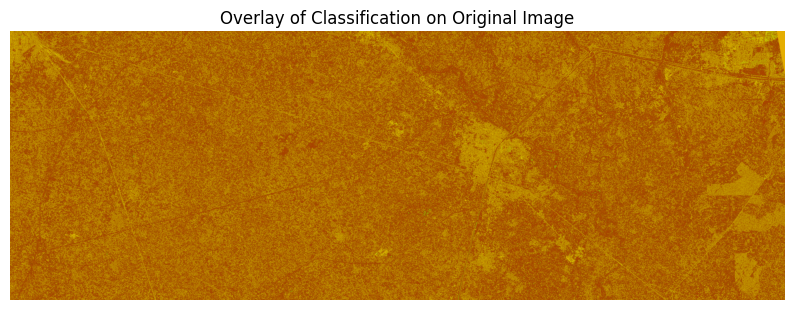

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

# Load the original Sentinel-1 image
original_image_path = '/content/drive/MyDrive/2024/Subset_S1A_IW_GRDH_1SDV_20240112T125550_20240112T125615_052074_064B35_B529_Cal_Spk_TC_dB.tif'
original_dataset = gdal.Open(original_image_path, gdal.GA_ReadOnly)

# Convert the original image to a 3-band RGB image by selecting bands (assuming a 2-band image)
bands = []
for i in range(1, original_dataset.RasterCount + 1):
    band = original_dataset.GetRasterBand(i).ReadAsArray()
    bands.append(cv2.normalize(band, None, 0, 255, cv2.NORM_MINMAX))

# If the original image has 2 bands, use them as Red and Green channels, and create a Blue channel (all zeros)
if len(bands) == 2:
    rgb_image = np.dstack([bands[0], bands[1], np.zeros_like(bands[0])])
else:
    rgb_image = np.dstack(bands[:3])  # Take the first 3 bands for RGB

# Load the classification result
classification_path = '/content/drive/MyDrive/UG_MEANSHIFT/Classification_Result_exp_2.tif'
classification_dataset = gdal.Open(classification_path, gdal.GA_ReadOnly)
classification = classification_dataset.GetRasterBand(1).ReadAsArray()

# Apply a colormap to the classification
classification_colored = cv2.applyColorMap((classification * 15).astype(np.uint8), cv2.COLORMAP_JET)  # Adjust scaling if needed

# Overlay the classification on the original image
overlay = cv2.addWeighted(rgb_image.astype(np.uint8), 0.6, classification_colored, 0.4, 0)

# Display the overlay using matplotlib
plt.figure(figsize=(10, 10))
plt.imshow(overlay)
plt.title('Overlay of Classification on Original Image')
plt.axis('off')
plt.show()

# # Optionally, save the overlay image as a new TIFF file
# output_path = '/content/drive/MyDrive/UG_MEANSHIFT/Overlay_Classification.tif'
# driver = gdal.GetDriverByName('GTiff')
# output_dataset = driver.Create(output_path, original_dataset.RasterXSize, original_dataset.RasterYSize,


Experiment_3 Dilation

In [3]:
#clustered image
clustered_image_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Result_5w_Subset_S1A_IW_GRDH_1SDV_20240112T125550_20240112T125615_052074_064B35_B529_Cal_Spk_TC_dB.tif'
clustered_dataset = gdal.Open(clustered_image_path, gdal.GA_ReadOnly)

# Read the cluster labels from the .tiff file
cluster_labels = clustered_dataset.GetRasterBand(1).ReadAsArray()

# Get geotransform and projection information
geotransform = clustered_dataset.GetGeoTransform()
projection = clustered_dataset.GetProjection()

In [65]:
print(cluster_labels)

[[ 5  1  8 ... 14 14 14]
 [ 5  8 10 ... 14 14 14]
 [ 1  1 10 ... 14 14 14]
 ...
 [ 0  6  6 ...  7  0  8]
 [ 0  6  6 ...  7  7  5]
 [ 0  6  7 ...  6  7  7]]


In [7]:
cluster_labels_uint8 = cluster_labels.astype(np.uint8)


In [14]:
# Define a kernel for dilation
kernel = np.ones((3, 3), np.uint8)

# Apply dilation
dilated_clusters = cv2.dilate(cluster_labels_uint8, kernel, iterations=10)


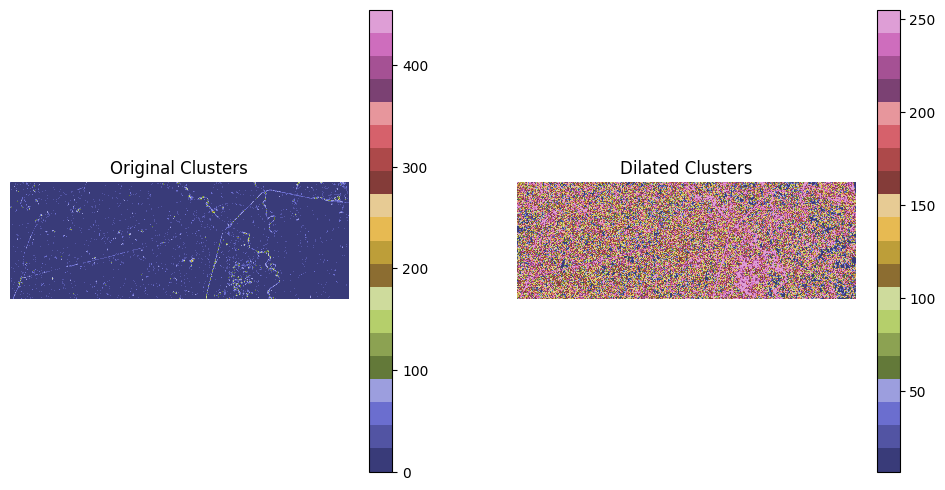

In [15]:
plt.figure(figsize=(12, 6))

# Original clusters
plt.subplot(1, 2, 1)
plt.title('Original Clusters')
plt.imshow(cluster_labels, cmap='tab20b')
plt.colorbar()
plt.axis('off')

# Dilated clusters
plt.subplot(1, 2, 2)
plt.title('Dilated Clusters')
plt.imshow(dilated_clusters, cmap='tab20b')
plt.colorbar()
plt.axis('off')

plt.show()


In [16]:
import plotly.express as px
import plotly.graph_objects as go

# Convert dilated clusters to RGB image for better visualization
dilated_clusters_rgb = np.stack([dilated_clusters]*3, axis=-1)

# Create a plotly figure
fig = px.imshow(dilated_clusters_rgb, color_continuous_scale='viridis')

# Update layout to improve visualization
fig.update_layout(
    title="Dilated Clusters Visualization",
    coloraxis_showscale=False,  # Hide color bar for RGB
    xaxis_title="X",
    yaxis_title="Y",
)

# Show the figure
fig.show()

In [11]:
print(len(dilated_clusters))
print(len(cluster_labels))

2110
2110


In [21]:
# Define a kernel for dilation
kernel = np.ones((5, 5), np.uint8)

# Apply dilation
dilated_clusters_5 = cv2.dilate(cluster_labels_uint8, kernel, iterations=10)


In [22]:
print(len(dilated_clusters_5))
print(len(cluster_labels))

2110
2110


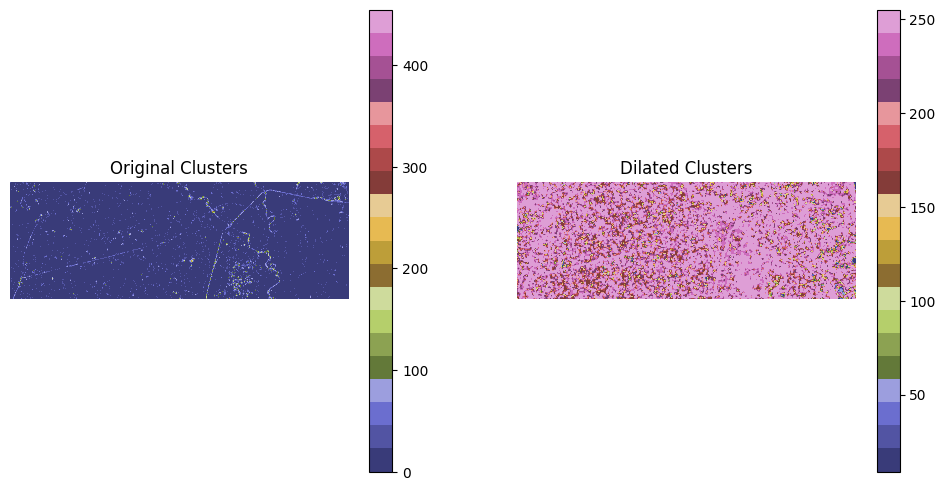

In [23]:
plt.figure(figsize=(12, 6))

# Original clusters
plt.subplot(1, 2, 1)
plt.title('Original Clusters')
plt.imshow(cluster_labels, cmap='tab20b')
plt.colorbar()
plt.axis('off')

# Dilated clusters
plt.subplot(1, 2, 2)
plt.title('Dilated Clusters')
plt.imshow(dilated_clusters_5, cmap='tab20b')
plt.colorbar()
plt.axis('off')

plt.show()


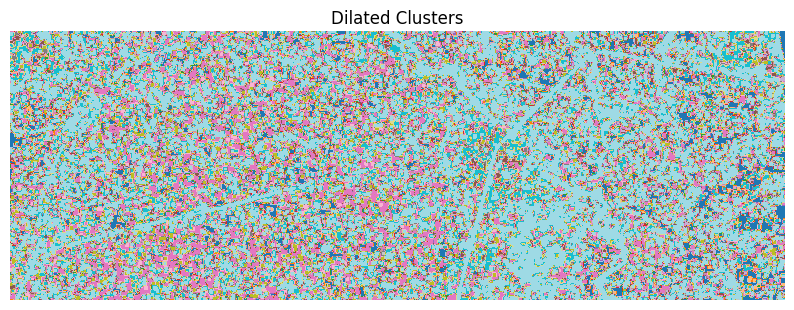

In [24]:
# Create a structuring element (kernel) for dilation
kernel = np.ones((5, 5), np.uint8)

# Apply dilation
dilated_clusters = cv2.dilate(cluster_labels.astype(np.uint8), kernel, iterations=7)

# Visualize the dilated clusters
plt.figure(figsize=(10, 10))
plt.imshow(dilated_clusters, cmap='tab20')
plt.title('Dilated Clusters')
plt.axis('off')
plt.show()

Different structuring element

In [12]:
rect_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
ellipse_kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
cross_kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (3, 3))

# Apply dilation with each kernel
dilated_rect = cv2.dilate(cluster_labels_uint8, rect_kernel, iterations=10)
dilated_ellipse = cv2.dilate(cluster_labels_uint8, ellipse_kernel, iterations=10)
dilated_cross = cv2.dilate(cluster_labels_uint8, cross_kernel, iterations=10)
dilated_vertical = cv2.dilate(cluster_labels_uint8, np.ones((3, 1), np.uint8), iterations=10)
dilated_horizontal = cv2.dilate(cluster_labels_uint8, np.ones((1, 3), np.uint8), iterations=10)

In [10]:
print(len(dilated_rect))
print(len(dilated_ellipse))
print(len(dilated_cross))
print(len(cluster_labels))

2110
2110
2110
2110


In [35]:
print(dilated_rect)

[[113 113 113 ...  14  14  14]
 [113 113 113 ...  14  14  14]
 [113 113 113 ...  14  14  14]
 ...
 [ 15  15  15 ... 251 251 251]
 [ 15  15  15 ... 251 251 251]
 [ 15  15  15 ... 251 251 251]]


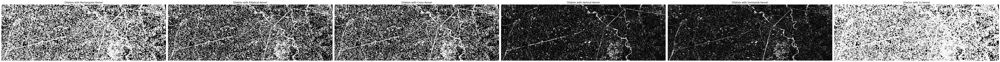

In [25]:
fig, ax = plt.subplots(1, 6, figsize=(70, 60))

ax[0].imshow(dilated_rect, cmap='gray')
ax[0].set_title('Dilation with Rectangular Kernel')
ax[0].axis('off')

ax[1].imshow(dilated_ellipse, cmap='gray')
ax[1].set_title('Dilation with Elliptical Kernel')
ax[1].axis('off')

ax[2].imshow(dilated_cross, cmap='gray')
ax[2].set_title('Dilation with Cross Kernel')
ax[2].axis('off')


ax[3].imshow(dilated_vertical, cmap='gray')
ax[3].set_title('Dilation with Vertical Kernel')
ax[3].axis('off')


ax[4].imshow(dilated_horizontal, cmap='gray')
ax[4].set_title('Dilation with Horizontal Kernel')
ax[4].axis('off')

ax[5].imshow(dilated_clusters, cmap='gray')
ax[5].set_title('Dilation with 1s Kernel')
ax[5].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
import plotly.express as px
import plotly.graph_objects as go

# Convert dilated clusters to RGB image for better visualization
dilated_clusters_rgb = np.stack([dilated_cross]*3, axis=-1)

# Create a plotly figure
fig = px.imshow(dilated_clusters_rgb, color_continuous_scale='viridis')

# Update layout to improve visualization
fig.update_layout(
    title="Dilated Clusters Visualization",
    coloraxis_showscale=False,  # Hide color bar for RGB
    xaxis_title="X",
    yaxis_title="Y",
)

# Show the figure
fig.show()

Classification

In [26]:
image_path = "/content/drive/MyDrive/2024/Subset_S1A_IW_GRDH_1SDV_20240112T125550_20240112T125615_052074_064B35_B529_Cal_Spk_TC_dB.tif"
dataset = gdal.Open(image_path, gdal.GA_ReadOnly)

# Convert the dataset to a numpy array, stacking all the bands
bands = []
for i in range(1, dataset.RasterCount + 1):
    band = dataset.GetRasterBand(i).ReadAsArray()
    bands.append(band)

# Stack the bands into a 3D array
original_image = np.stack(bands, axis=2)

In [175]:
csv_file_path = '/content/drive/MyDrive/UG_MEANSHIFT/Cluster_result/Annotations_combined.csv'
df = pd.read_csv(csv_file_path)

In [176]:
len(df)

1300

In [177]:
def geo_to_pixel(geo_x, geo_y, geotransform):
    ulx = geotransform[0]  # upper left x
    uly = geotransform[3]  # upper left y
    xres = geotransform[1]  # pixel width
    yres = geotransform[5]  # pixel height (negative value)

    pixel_x = int((geo_x - ulx) / xres)
    pixel_y = int((geo_y - uly) / yres)

    return pixel_x, pixel_y

df['pixel_x'] = df.apply(lambda row: geo_to_pixel(row['Lon'], row['Lat'], geotransform)[0], axis=1)
df['pixel_y'] = df.apply(lambda row: geo_to_pixel(row['Lon'], row['Lat'], geotransform)[1], axis=1)

In [32]:
df.head()

,Lon,Lat,Class,pixel_x,pixel_y
0,77.966060,29.929966,bs,4715,263
1,77.966241,29.929060,bs,4717,273
2,77.965601,29.928443,bs,4710,280
3,77.965837,29.929430,bs,4712,269
4,77.966668,29.929501,bs,4722,268


In [117]:
# height, width = dilated_rect.shape

# # Create a dictionary mapping (cluster_id -> class_label)
# cluster_label_map = {}
# for _, row in df.iterrows():
#     pixel_x = int(row['pixel_x'])
#     pixel_y = int(row['pixel_y'])

#     # Check if indices are within bounds
#     if 0 <= pixel_x < width and 0 <= pixel_y < height:
#         cluster_id = dilated_rect[pixel_y, pixel_x]  # Note the order: (row, col)
#         cluster_label_map[cluster_id] = row['Class']
#     else:
#         print(f"Warning: Index ({pixel_y}, {pixel_x}) is out of bounds.")

# # Convert to a list of tuples if needed (e.g., for extracting features)
# labeled_clusters = list(cluster_label_map.items())

In [118]:
class_mapping = {'bs' : 1, 'ms': 2, 'sv' : 3, 'tv' : 4, 'ur' : 5, 'w': 6}
class_names = {1: 'bs', 2: 'ms', 3: 'sv', 4: 'tv', 5: 'ur', 6: 'w'}

#Will first count the number of classes assigned to match pixel of the clusters, the most frequent class will be assigned
#the main class label
# Create a dictionary to map each cluster to class counts
cluster_class_counts = defaultdict(lambda: defaultdict(int))
for _, row in df.iterrows():
    pixel_x, pixel_y = row['pixel_x'], row['pixel_y']
    if 0 <= pixel_x < dilated_rect.shape[1] and 0 <= pixel_y < dilated_rect.shape[0]:
        cluster_id = dilated_rect[pixel_y, pixel_x]
        class_id = class_mapping[row['Class']]
        cluster_class_counts[cluster_id][class_id] += 1

print("Sample cluster to class count mapping:\n", dict(list(cluster_class_counts.items())[:70]))

# Assign the most frequent class to each cluster
classified_image = np.zeros_like(dilated_rect, dtype=np.uint8)
for cluster_id, class_count in cluster_class_counts.items():
    most_frequent_class = max(class_count, key=class_count.get)
    classified_image[dilated_rect == cluster_id] = most_frequent_class

Sample cluster to class count mapping:
 {10: defaultdict(<class 'int'>, {3: 21, 4: 5, 1: 22, 6: 4, 5: 1}), 244: defaultdict(<class 'int'>, {2: 144, 1: 21, 4: 18, 5: 4, 6: 39, 3: 24}), 8: defaultdict(<class 'int'>, {3: 4, 1: 2}), 11: defaultdict(<class 'int'>, {4: 13, 1: 12, 6: 3, 3: 13, 5: 4, 2: 3}), 164: defaultdict(<class 'int'>, {1: 49, 3: 65, 4: 36, 6: 20, 5: 5, 2: 15}), 12: defaultdict(<class 'int'>, {5: 6, 4: 19, 3: 5, 6: 1, 1: 11}), 251: defaultdict(<class 'int'>, {3: 61, 1: 76, 4: 24, 2: 31, 6: 17, 5: 20}), 232: defaultdict(<class 'int'>, {4: 14, 5: 84, 3: 3, 1: 5}), 57: defaultdict(<class 'int'>, {4: 3, 5: 2}), 121: defaultdict(<class 'int'>, {3: 7, 4: 3, 1: 3, 6: 1, 5: 1}), 9: defaultdict(<class 'int'>, {1: 11, 3: 12, 6: 4, 4: 2, 2: 1}), 17: defaultdict(<class 'int'>, {4: 8, 5: 24}), 124: defaultdict(<class 'int'>, {6: 2, 4: 18, 1: 12, 3: 7, 2: 3}), 22: defaultdict(<class 'int'>, {5: 5, 4: 2}), 49: defaultdict(<class 'int'>, {3: 1, 1: 3, 5: 5, 4: 2, 6: 1}), 18: defaultdict(<c

In [155]:
print(len(classified_image))

2110


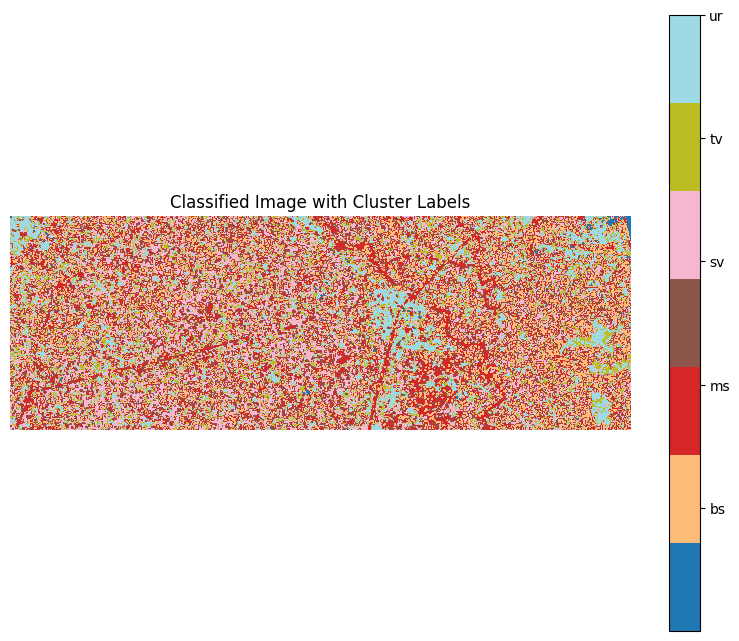

In [38]:
import matplotlib.pyplot as plt

# Define a colormap that maps class IDs to colors
cmap = plt.get_cmap('tab20', len(class_names) + 1)  # +1 for the background (if any)

# Plot the classified image
plt.figure(figsize=(10, 8))
plt.imshow(classified_image, cmap=cmap)
cbar = plt.colorbar(ticks=range(1, len(class_names) + 1))
cbar.ax.set_yticklabels([class_names[i] for i in range(1, len(class_names) + 1)])
plt.title('Classified Image with Cluster Labels')
plt.axis('off')
plt.show()

In [156]:
features = []
labels = []


for _, row in df.iterrows():
    pixel_x, pixel_y = row['pixel_x'], row['pixel_y']
    if 0 <= pixel_x < classified_image.shape[1] and 0 <= pixel_y < classified_image.shape[0]:
        class_label = classified_image[pixel_y, pixel_x]
        features.append(class_label)
        labels.append(class_mapping[row['Class']])

features = np.array(features).reshape(-1, 1)
labels = np.array(labels)

In [157]:
print(len(labels))

1266


In [178]:

# Create a dictionary to map each cluster to class counts
cluster_class_counts = defaultdict(lambda: defaultdict(int))

# Fill in the counts from the dataframe
for _, row in df.iterrows():
    pixel_x, pixel_y = row['pixel_x'], row['pixel_y']
    if 0 <= pixel_x < classified_image.shape[1] and 0 <= pixel_y < classified_image.shape[0]:
        cluster_id = classified_image[pixel_y, pixel_x]
        class_id = class_mapping[row['Class']]
        cluster_class_counts[cluster_id][class_id] += 1

# Map each cluster to the most frequent class
cluster_to_class = {}
for cluster_id, class_count in cluster_class_counts.items():
    if class_count:  # Ensure that class_count is not empty
        most_frequent_class = max(class_count, key=class_count.get)
        cluster_to_class[cluster_id] = most_frequent_class

# Prepare features and labels
features = []
labels = []

for _, row in df.iterrows():
    pixel_x, pixel_y = row['pixel_x'], row['pixel_y']
    if 0 <= pixel_x < classified_image.shape[1] and 0 <= pixel_y < classified_image.shape[0]:
        cluster_id = classified_image[pixel_y, pixel_x]
        if cluster_id in cluster_to_class:
            features.append(cluster_id)
            labels.append(cluster_to_class[cluster_id])

features = np.array(features).reshape(-1, 1)
labels = np.array(labels)

In [179]:
clf = RandomForestClassifier(n_jobs=1)
clf.fit(features, labels)

RandomForestClassifier(n_jobs=1)

In [180]:
predicted_labels = clf.predict(features)

In [182]:
# Step 2: Create a classified image
classified_image_result = np.zeros_like(dilated_rect, dtype=np.uint8)

# Get the unique cluster IDs from the dilated_rect image
unique_clusters = np.unique(dilated_rect)

# Loop through each cluster ID and assign the predicted label
for i, cluster_id in enumerate(unique_clusters):
    if cluster_id == 0:
        continue
    classified_image_result[dilated_rect == cluster_id] = predicted_labels[i - 1]

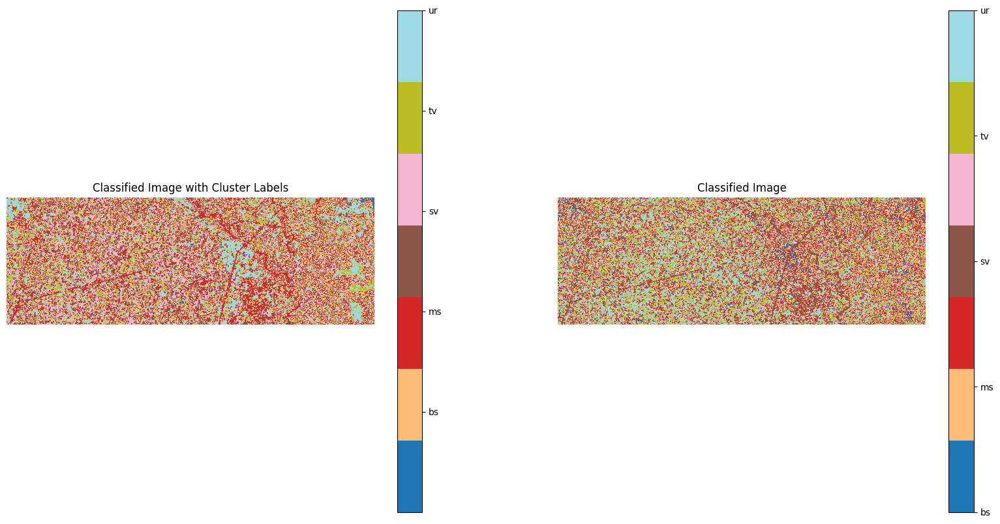

In [183]:
import matplotlib.pyplot as plt

# Define a colormap that maps class IDs to colors
cmap = plt.get_cmap('tab20', len(class_names) + 1)  # +1 for the background (if any)

# Create a figure with two subplots
fig, ax = plt.subplots(1, 2, figsize=(20, 10))  # Adjust figsize as needed

# Plot the first classified image
ax[0].imshow(classified_image, cmap=cmap)
cbar0 = plt.colorbar(ax[0].imshow(classified_image, cmap=cmap), ax=ax[0], ticks=range(1, len(class_names) + 1))
cbar0.ax.set_yticklabels([class_names[i] for i in range(1, len(class_names) + 1)])
ax[0].set_title('Classified Image with Cluster Labels')
ax[0].axis('off')

# Plot the second classified image
ax[1].imshow(classified_image_result, cmap=cmap)
cbar1 = plt.colorbar(ax[1].imshow(classified_image_result, cmap=cmap), ax=ax[1], ticks=range(1, len(class_names) + 1))
cbar1.ax.set_yticklabels([class_names[i] for i in range(1, len(class_names) + 1)])
ax[1].set_title('Classified Image')
ax[1].axis('off')

plt.show()


In [184]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_recall_fscore_support, confusion_matrix, classification_report


# Flatten the images to 1D arrays for comparison
y_true = classified_image.flatten()
y_pred = classified_image_result.flatten()

# Compute accuracy
accuracy = accuracy_score(y_true, y_pred)

# Compute precision, recall, F1-score
precision, recall, f1, _ = precision_recall_fscore_support(y_true, y_pred, average='weighted', zero_division=0)

# Compute confusion matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Print results
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

# Optionally, print a detailed classification report
print("\nClassification Report:")
print(classification_report(y_true, y_pred))


Accuracy: 0.0672
Precision: 0.0584
Recall: 0.0672
F1 Score: 0.0624

Classification Report:


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           0       0.00      0.00      0.00    131567
           1       0.00      0.00      0.00   3731622
           2       0.00      0.00      0.00   1343435
           3       0.01      0.01      0.01   3253940
           4       0.27      0.32      0.30   2617636
           5       0.00      0.00      0.00   1765370

    accuracy                           0.07  12843570
   macro avg       0.05      0.05      0.05  12843570
weighted avg       0.06      0.07      0.06  12843570



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [ ]:
classifier = RandomForestClassifier(n_jobs=-1)
classifier.fit(features, labels)

# Step 6: Predict the classes for all clusters
cluster_ids = np.unique(dilated_rect)
all_features = []
for cluster_id in cluster_ids:
    if cluster_id == 0:
        continue
    segment_pixels = original_image[dilated_rect == cluster_id]
    segment_mean = segment_pixels.mean(axis=0)
    segment_std = segment_pixels.std(axis=0)
    all_features.append(np.concatenate([segment_mean, segment_std]))

predicted_labels = classifier.predict(all_features)

In [ ]:
# Create a mapping from label names to integers
label_to_int = {label: idx + 1 for idx, label in enumerate(np.unique(predicted_labels))}
int_labels = [label_to_int[label] for label in predicted_labels]

# Ensure that the predicted labels are integers
int_labels = np.array(int_labels)

In [ ]:
# Ensure classified_image is initialized correctly
classified_image = np.copy(dilated_rect)

# Create a dictionary to map cluster_id to predicted labels
cluster_to_label = dict(zip(np.unique(dilated_rect), int_labels))

# Map cluster IDs to predicted labels
for cluster_id, label in cluster_to_label.items():
    if cluster_id == 0:
        continue
    classified_image[dilated_rect == cluster_id] = label

# Save or visualize the classified image
plt.figure(figsize=(10, 8))
plt.imshow(classified_image, cmap='tab10')  # Choose a colormap
plt.title('Classified Image')
plt.colorbar()
plt.show()

IndexError: index 255 is out of bounds for axis 0 with size 255